# PROJECT: Delivering RIS (PP8)

## Check if GPU is available

In [1]:
from tensorflow.python.client import device_lib

def get_gpu_details():
    devices = device_lib.list_local_devices()
    for device in devices:
        if device.device_type == 'GPU':
            print(f"Device Name: {device.name}")
            print(f"Memory Limit: {device.memory_limit} bytes")
            print(f"Description: {device.physical_device_desc}")

get_gpu_details()


## Get Dataset

In [2]:
#!pip install tensorflow-datasets

In [3]:
import tensorflow_datasets as tfds

def describe_dataset(dataset_name: str) -> None:
    # Load the dataset with its information
    _, ds_info = tfds.load(name=dataset_name, with_info=True)
    
    # Print the dataset name and description
    print(f"Dataset Name: {ds_info.name}")
    print("Description:", ds_info.description)
    print("Homepage:", ds_info.homepage)
    print("Data directory:", ds_info.data_dir)
    print("Dataset size:", ds_info.dataset_size)
    print("Download size:", ds_info.download_size)
    print("File format:", ds_info.file_format)
    
    # Print the features of the dataset
    print("\nFeatures:")
    for feature, feature_info in ds_info.features.items():
        print(f"{feature}: {feature_info}")

    # Print information about each split (e.g., train, test)
    print("\nSplits:")
    for split, split_info in ds_info.splits.items():
        print(f"{split.capitalize()} split: {split_info.num_examples} examples")

    # Print the citation if available
    print("\nCitation:", ds_info.citation)

# Call the function with 'caltech101'
describe_dataset('caltech101')


C:\Users\tomui\anaconda3\envs\tensorflow_new\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Dataset Name: caltech101
Description: Caltech-101 consists of pictures of objects belonging to 101 classes, plus one
`background clutter` class. Each image is labelled with a single object. Each
class contains roughly 40 to 800 images, totalling around 9k images. Images are
of variable sizes, with typical edge lengths of 200-300 pixels. This version
contains image-level labels only. The original dataset also contains bounding
boxes.
Homepage: https://doi.org/10.22002/D1.20086
Data directory: C:\Users\tomui\tensorflow_datasets\caltech101\3.0.2
Dataset size: 132.86 MiB
Download size: 131.05 MiB
File format: FileFormat.TFRECORD

Features:
image: Image(shape=(None, None, 3), dtype=uint8)
label: ClassLabel(shape=(), dtype=int64, num_classes=102)
image/file_name: Text(shape=(), dtype=string)

Splits:
Train split: 3059 examples
Test split: 6085 examples

Citation: @article{FeiFei2004LearningGV,
  title={Learning Generative Visual Models from Few Training Examples: An Incremental Bayesian Appr

In [4]:
# Load the dataset into a single dataset object and then split it manually
dataset = tfds.load('caltech101', split='all', as_supervised=True)

## Show samples

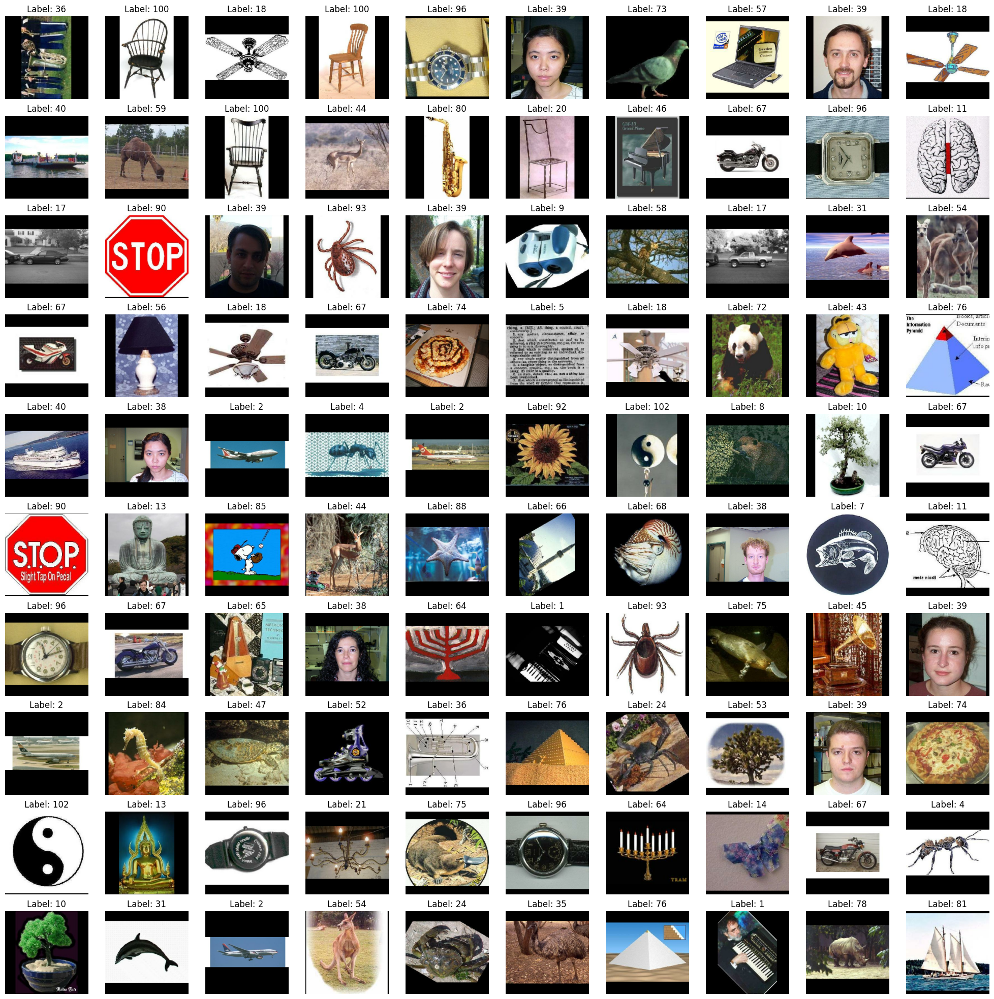

In [5]:
import tensorflow as tf
import matplotlib.pyplot as plt

# Collect 100 random samples
random_samples = dataset.shuffle(100).take(100)

def preprocess_image_2(image, label):
    image = tf.image.resize_with_pad(image, target_height=224, target_width=224)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

preprocessed_samples = random_samples.map(preprocess_image_2)

def show_images(images, labels):
    num_columns = 10
    num_rows = len(images) // num_columns

    plt.figure(figsize=(25, 25))

    for i, (image, label) in enumerate(zip(images, labels)):
        plt.subplot(num_rows, num_columns, i + 1)
        plt.imshow(image)
        plt.title(f"Label: {label + 1}")
        plt.axis('off')

    plt.show()

images_list, labels_list = zip(*preprocessed_samples.as_numpy_iterator())

show_images(images_list, labels_list)


## Split dataset

In [6]:
total_samples = dataset.cardinality().numpy()

train_size = int(0.8 * total_samples)
test_size = total_samples - train_size

train_dataset = dataset.take(train_size)
test_dataset = dataset.skip(train_size)

print(f"Training dataset size: {train_size}")
print(f"Test dataset size: {test_size}")

Training dataset size: 7315
Test dataset size: 1829


## Preproces images

In [7]:
import tensorflow as tf

def preprocess_image(image, label):
    image = tf.cast(image, tf.float32)
    image = tf.image.resize(image, [224, 224])
    return image, label

ds_train = train_dataset.map(preprocess_image)
ds_test = test_dataset.map(preprocess_image)

batch_size = 32
ds_train = ds_train.batch(batch_size)
ds_test = ds_test.batch(batch_size)

ds_train = ds_train.prefetch(tf.data.AUTOTUNE)
ds_test = ds_test.prefetch(tf.data.AUTOTUNE)


## Check representation of labels with image counts

In [8]:
def collect_labels(dataset):
    labels = []
    for _, label in dataset:
        labels.extend(label.numpy().tolist()) 
    return labels

train_labels = collect_labels(ds_train)
test_labels = collect_labels(ds_test)

def count_labels_tf(labels):
    labels_tensor = tf.constant(labels)
    unique, idx, count = tf.unique_with_counts(labels_tensor)
    return dict(zip(unique.numpy(), count.numpy()))

train_label_counts_tf = count_labels_tf(train_labels)
test_label_counts_tf = count_labels_tf(test_labels)

print("Train label counts with TensorFlow:", train_label_counts_tf)
print(len(train_label_counts_tf))
print("Test label counts with TensorFlow:", test_label_counts_tf)
print(len(test_label_counts_tf))

Train label counts with TensorFlow: {70: 46, 10: 73, 51: 30, 7: 41, 87: 68, 79: 35, 94: 62, 54: 85, 99: 50, 83: 48, 26: 41, 39: 54, 60: 53, 32: 62, 8: 32, 67: 46, 4: 347, 89: 50, 66: 578, 73: 50, 9: 97, 75: 50, 37: 316, 17: 46, 38: 324, 19: 52, 57: 138, 93: 63, 52: 47, 47: 39, 43: 32, 92: 44, 49: 66, 30: 50, 71: 35, 55: 51, 64: 32, 101: 51, 58: 66, 56: 65, 95: 180, 1: 567, 0: 50, 63: 73, 72: 44, 23: 61, 16: 98, 20: 81, 74: 34, 80: 58, 59: 38, 25: 45, 35: 54, 45: 76, 91: 65, 77: 50, 40: 57, 65: 60, 98: 34, 90: 34, 53: 68, 29: 45, 15: 37, 44: 46, 12: 68, 34: 49, 6: 48, 3: 37, 42: 33, 36: 73, 84: 32, 46: 79, 100: 37, 81: 38, 13: 77, 48: 43, 28: 53, 31: 52, 68: 32, 85: 53, 88: 49, 33: 50, 61: 38, 82: 74, 27: 50, 96: 36, 97: 49, 76: 64, 22: 52, 2: 38, 14: 43, 11: 39, 5: 43, 18: 48, 86: 39, 78: 42, 24: 58, 69: 38, 62: 39, 50: 69, 41: 39, 21: 44}
102
Test label counts with TensorFlow: {38: 111, 100: 2, 1: 233, 40: 10, 37: 119, 45: 23, 30: 15, 93: 23, 10: 25, 66: 220, 49: 22, 57: 62, 31: 16, 6

In [9]:
import numpy as np

# Calculate statistical information for train and test distributions
train_values = np.array(list(train_label_counts_tf.values()))
test_values = np.array(list(test_label_counts_tf.values()))

print("Train Distribution Statistics:")
print("Mean:", np.mean(train_values))
print("Median:", np.median(train_values))
print("Std Dev:", np.std(train_values))

print("\nTest Distribution Statistics:")
print("Mean:", np.mean(test_values))
print("Median:", np.median(test_values))
print("Std Dev:", np.std(test_values))

# Find classes with low representation
low_threshold = 5  # Threshold for considering a class underrepresented
underrepresented_train = {k: v for k, v in train_label_counts_tf.items() if v < low_threshold}
underrepresented_test = {k: v for k, v in test_label_counts_tf.items() if v < low_threshold}

print("\nUnderrepresented Classes in Training Data:", underrepresented_train)
print("Underrepresented Classes in Testing Data:", underrepresented_test)


Train Distribution Statistics:
Mean: 71.7156862745098
Median: 50.0
Std Dev: 87.2992798581106

Test Distribution Statistics:
Mean: 18.474747474747474
Median: 10.0
Std Dev: 36.33245576764593

Underrepresented Classes in Training Data: {}
Underrepresented Classes in Testing Data: {100: 2, 62: 1, 47: 3, 59: 3, 11: 4, 69: 1, 73: 3, 2: 4, 43: 2, 34: 4, 21: 3, 5: 4, 84: 3, 8: 1, 71: 3, 51: 1, 17: 1, 96: 1, 68: 3, 42: 1, 81: 1, 70: 1, 90: 1, 72: 1}


## Building the Model Using EfficientNetV2

In [10]:
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import efficientnet_v2

def build_model(num_classes: int):

    base_model = efficientnet_v2.EfficientNetV2S(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
    base_model.trainable = False

    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.5)(x)
    predictions = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=predictions)

    optimizer = Adam(learning_rate=0.0001)
    model.compile(optimizer=optimizer, loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    
    return model

model = build_model(102) # 102 classes: 101 + background class

## Set Up Callbacks

In [11]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

early_stopping = EarlyStopping(
    monitor='val_loss', 
    patience=20, 
    verbose=1,
    restore_best_weights=True
)

reduce_lr = ReduceLROnPlateau(
    monitor='val_loss', 
    factor=0.1,
    patience=7, 
    verbose=1
)

callbacks = [early_stopping, reduce_lr]


## Training the Model

In [12]:
epochs = 100

history = model.fit(
    ds_train,
    epochs=epochs,
    validation_data=ds_test,
    callbacks=callbacks
)


Epoch 1/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 323s 1s/step - accuracy: 0.2896 - loss: 3.7098 - val_accuracy: 0.8573 - val_loss: 1.2919 - learning_rate: 1.0000e-04
Epoch 2/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 321s 1s/step - accuracy: 0.7635 - loss: 1.5965 - val_accuracy: 0.9267 - val_loss: 0.5435 - learning_rate: 1.0000e-04
Epoch 3/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 328s 1s/step - accuracy: 0.8827 - loss: 0.7343 - val_accuracy: 0.9404 - val_loss: 0.3478 - learning_rate: 1.0000e-04
Epoch 4/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 328s 1s/step - accuracy: 0.9096 - loss: 0.4633 - val_accuracy: 0.9453 - val_loss: 0.2795 - learning_rate: 1.0000e-04
Epoch 5/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 329s 1s/step - accuracy: 0.9240 - loss: 0.3462 - val_accuracy: 0.9481 - val_loss: 0.2462 - learning_rate: 1.0000e-04
Epoch 6/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 328s 1s/step - accuracy: 0.9360 - loss: 0.2738 - val_accuracy: 0.9475 - val_loss: 0.2235 - learning_rate: 1.0000e-04
Epoch 7/100
229/229 ━━━━━━━━━━━━━━━━━━━━ 332s 1s/ste

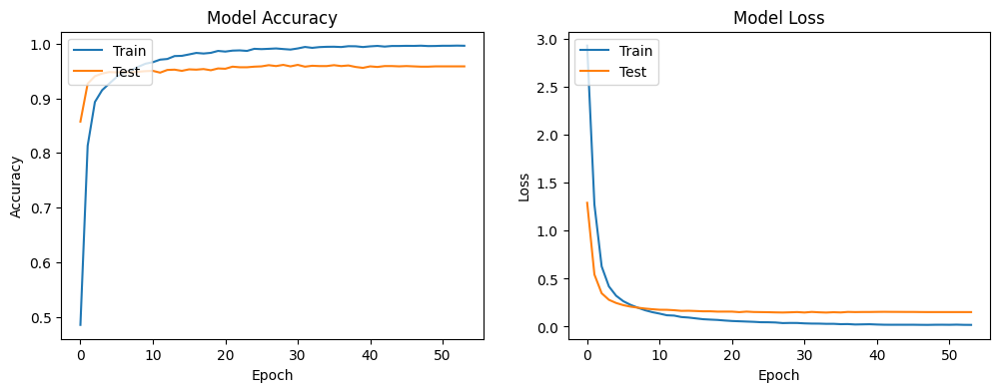

In [13]:
import matplotlib.pyplot as plt

def plot_training_history(history):
    fig, ax = plt.subplots(1, 2, figsize=(12, 4))

    # Plot training & validation accuracy values
    ax[0].plot(history.history['accuracy'])
    ax[0].plot(history.history['val_accuracy'])
    ax[0].set_title('Model Accuracy')
    ax[0].set_ylabel('Accuracy')
    ax[0].set_xlabel('Epoch')
    ax[0].legend(['Train', 'Test'], loc='upper left')

    # Plot training & validation loss values
    ax[1].plot(history.history['loss'])
    ax[1].plot(history.history['val_loss'])
    ax[1].set_title('Model Loss')
    ax[1].set_ylabel('Loss')
    ax[1].set_xlabel('Epoch')
    ax[1].legend(['Train', 'Test'], loc='upper left')

    plt.show()

plot_training_history(history)

## Model Evaluation Metrics

In [14]:
test_loss, test_accuracy = model.evaluate(ds_test)
print(f"Test Loss: {test_loss}")
print(f"Test Accuracy: {test_accuracy}")


58/58 ━━━━━━━━━━━━━━━━━━━━ 66s 1s/step - accuracy: 0.9611 - loss: 0.1303
Test Loss: 0.14648385345935822
Test Accuracy: 0.9589939713478088


In [15]:
#!pip install scikit-learn

In [16]:
from sklearn.metrics import classification_report

# Collect all labels and predictions
y_true = np.array([])
y_pred = []

for images, labels in ds_test:
    preds = model.predict(images, verbose=0)
    y_pred.extend(preds)
    y_true = np.concatenate([y_true, labels.numpy()])

y_pred = np.array(y_pred)
y_pred_classes = np.argmax(y_pred, axis=1)

# Print classification report
print(classification_report(y_true, y_pred_classes, zero_division=0))


              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00         5
         1.0       1.00      1.00      1.00       233
         2.0       0.50      1.00      0.67         4
         3.0       1.00      1.00      1.00         5
         4.0       0.91      0.85      0.88       120
         5.0       1.00      0.75      0.86         4
         6.0       1.00      0.67      0.80         6
         7.0       1.00      1.00      1.00         5
         8.0       0.50      1.00      0.67         1
         9.0       1.00      0.94      0.97        31
        10.0       1.00      0.92      0.96        25
        11.0       0.67      1.00      0.80         4
        12.0       1.00      1.00      1.00        17
        13.0       0.86      0.86      0.86        14
        14.0       1.00      1.00      1.00         7
        15.0       0.83      0.83      0.83         6
        16.0       1.00      1.00      1.00        25
        17.0       1.00    

## Save Model

In [17]:
# TensorFlow 2.10 for save of EfficientNetB0 model throws errors, bug fixed in later TensorFlow versions. TensorFlow 2.10 installed with purpose of using GPU on Windows
from tensorflow.keras.models import save_model
save_model(model, "model.h5")
model.save('my_model.keras')


In [18]:
#!pip install matplotlib

## Find Layer for Feature Extraction

In [19]:
# model.summary()
for layer in model.layers:
    print(layer.name)

input_layer
rescaling
stem_conv
stem_bn
stem_activation
block1a_project_conv
block1a_project_bn
block1a_project_activation
block1a_add
block1b_project_conv
block1b_project_bn
block1b_project_activation
block1b_drop
block1b_add
block2a_expand_conv
block2a_expand_bn
block2a_expand_activation
block2a_project_conv
block2a_project_bn
block2b_expand_conv
block2b_expand_bn
block2b_expand_activation
block2b_project_conv
block2b_project_bn
block2b_drop
block2b_add
block2c_expand_conv
block2c_expand_bn
block2c_expand_activation
block2c_project_conv
block2c_project_bn
block2c_drop
block2c_add
block2d_expand_conv
block2d_expand_bn
block2d_expand_activation
block2d_project_conv
block2d_project_bn
block2d_drop
block2d_add
block3a_expand_conv
block3a_expand_bn
block3a_expand_activation
block3a_project_conv
block3a_project_bn
block3b_expand_conv
block3b_expand_bn
block3b_expand_activation
block3b_project_conv
block3b_project_bn
block3b_drop
block3b_add
block3c_expand_conv
block3c_expand_bn
block3c_exp

# Experiment RIS from here

## Feature Extraction

In [31]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
import random

# Define a function to preprocess images
def preprocess_image(image, label):
    image = tf.cast(image, tf.float32)
    image = tf.image.resize(image, [224, 224])
    return image, label

# Load the dataset and apply preprocessing
dataset_original = tfds.load('caltech101', split='all', as_supervised=True)
dataset = dataset_original.map(preprocess_image)

# Batch and prefetch the dataset
batch_size = 32
dataset = dataset.batch(batch_size)
dataset = dataset.prefetch(tf.data.AUTOTUNE)

feature_extractor = tf.keras.Model(inputs=model.input, outputs=model.get_layer('global_average_pooling2d').output)

# Extract features from the dataset
def extract_features(dataset):
    features = []
    labels = []
    for images, batch_labels in dataset:
        batch_features = feature_extractor(images)
        features.extend(batch_features.numpy())
        labels.extend(batch_labels.numpy())
    return np.array(features), np.array(labels)

# Extract features
features, labels = extract_features(dataset)

## Save Features

In [32]:
np.save('features_.npy', features)
np.save('labels_.npy', labels)
print("Image feature data saved")

Image feature data saved


## Load Features

In [33]:
import numpy as np
from numpy.typing import NDArray
from typing import Any

features: NDArray[Any] = np.load('features_.npy')
labels: NDArray[Any] = np.load('labels_.npy')
print("Image feature data loaded")

Image feature data loaded


## Nearest Neighbours

Nearest Neighbors indices: [[6175 7486 1647 4065 3106 5293 5483 7188 8005 4256]]
Distances: [[0.         5.27486335 5.82407515 6.0775987  6.31334617 6.35969654
  6.82637455 7.16868248 7.27358609 7.28752409]]


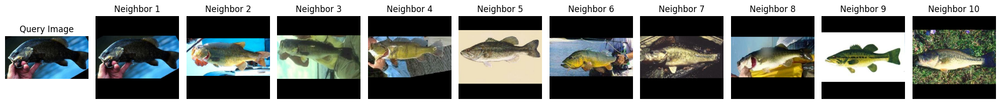

Nearest Neighbors indices: [[4230 4517 1528 3863 7614 4776 7870 6915 8294 2091]]
Distances: [[0.         3.90872246 3.91294214 4.02506251 4.04728085 4.12821126
  4.15063197 4.15807536 4.18531498 4.18582374]]


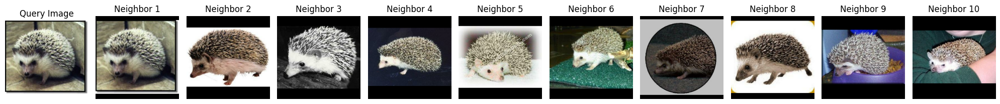

Nearest Neighbors indices: [[6882  708 3513 7838 8372 2938 1365 8513 6397 1553]]
Distances: [[0.         6.02428191 6.23922998 6.4334865  6.50104419 6.66920282
  6.8481812  6.99163083 7.02775848 7.13517901]]


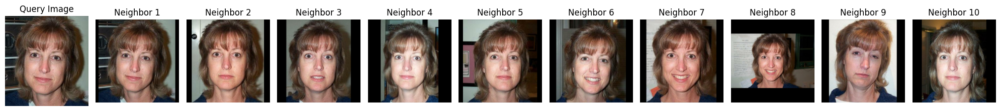

Nearest Neighbors indices: [[3967 7577 4696 5205 2101 9021 3154 5391  147 5213]]
Distances: [[0.         6.29531786 6.3708266  6.472535   6.77489406 6.81278829
  6.89869483 6.95632482 7.08656853 7.09375897]]


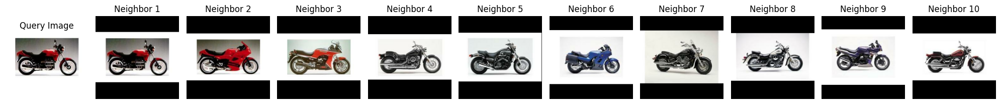

Nearest Neighbors indices: [[1613 4676  178 8732 2718  239 7833 3223 7488 2637]]
Distances: [[0.         7.39309959 7.77552395 7.8696771  7.90013648 8.12028281
  8.13590602 8.16298161 8.2729413  8.54902323]]


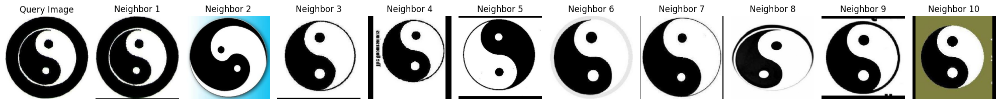

Nearest Neighbors indices: [[1046 6930 3515 6108 5212 6952 6787 4144 1937 8263]]
Distances: [[0.         3.90964058 4.02715382 4.25271569 4.27621931 4.28742451
  4.29163515 4.34352651 4.36386859 4.36548471]]


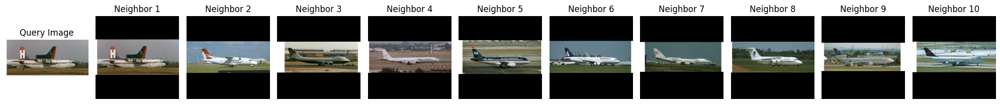

Nearest Neighbors indices: [[4751 8733 3978 1025 4077 6755  453 1604 6005 9037]]
Distances: [[ 0.         10.19055409 11.31172899 11.60018991 11.60653775 12.00358376
  12.09149859 12.13113213 12.16112143 12.1768312 ]]


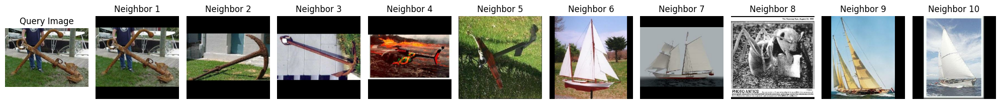

Nearest Neighbors indices: [[3817 3578 8077 3045 4815 7933 3375 4673 8838 3783]]
Distances: [[0.         4.04283618 4.5618081  4.75590869 4.83669595 4.84723112
  4.87889374 4.95808968 4.98426002 5.11939248]]


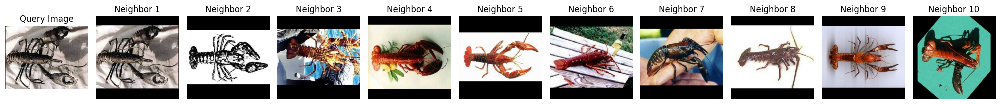

Nearest Neighbors indices: [[1400 2259 3957 8623 7937 8214 6578 4730 6640 8936]]
Distances: [[0.         2.57323962 5.22716038 5.32686446 5.39621432 5.39915007
  5.40184606 5.40263355 5.43692402 5.46436453]]


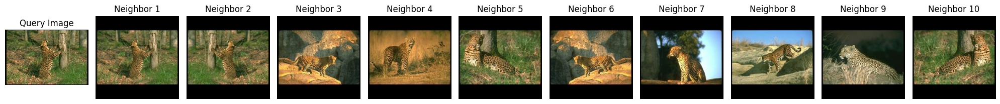

Nearest Neighbors indices: [[1824 6374 2535 2119 6558 3040 3001 8470 4333 3418]]
Distances: [[0.         1.54152787 1.57506171 1.79561688 3.12088353 3.13261667
  3.14276723 3.23532806 3.27278869 3.33232486]]


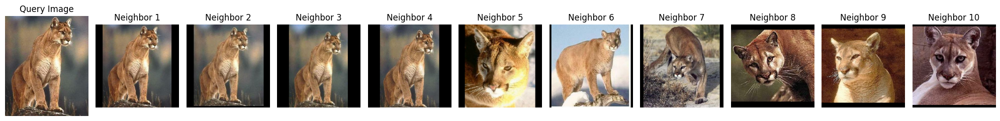

In [34]:
# Train the Nearest Neighbors model
nn = NearestNeighbors(n_neighbors=10, algorithm='ball_tree')
nn.fit(features)

def preprocess_image_2(image, label):
    image = tf.image.resize_with_pad(image, target_height=224, target_width=224)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

# Select random query images
random_query_images = random.sample(range(len(features)), 10)

# Find nearest neighbors for each query image and visualize
for query_index in random_query_images:
    distances, neighbor_indices = nn.kneighbors([features[query_index]])
    print("Nearest Neighbors indices:", neighbor_indices)
    print("Distances:", distances)
        
    # Get the actual images corresponding to the neighbor indices and resize them
    neighbor_images = []
    for index in neighbor_indices[0]:
        image, _ = next(iter(dataset_original.skip(index).take(1)))
        resized_image = preprocess_image_2(image, None)[0]
        neighbor_images.append(resized_image)

    # Define a function to visualize images
    def visualize_images(query_image, neighbor_images):
        # Display the query image
        plt.figure(figsize=(20, 5))
        plt.subplot(1, len(neighbor_images) + 1, 1)
        plt.imshow(query_image)  # Display the query image
        plt.title('Query Image')
        plt.axis('off')
    
        # Display images of nearest neighbors
        for i, image in enumerate(neighbor_images, start=2):
            plt.subplot(1, len(neighbor_images) + 1, i)
            plt.imshow(image)  # Display the neighbor image
            plt.title(f'Neighbor {i-1}')
            plt.axis('off')
    
        plt.tight_layout()
        plt.show()
    
    # Call the visualization function
    visualize_images(next(iter(dataset_original.skip(query_index).take(1)))[0], neighbor_images)

## Cosine Similarity

Nearest Neighbors indices: [6175 7486 1647 4065 5293 3106 5483 1358 8005  462]


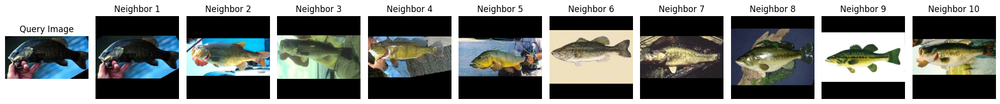

Nearest Neighbors indices: [4230 4517 1528 3863 7614 4776 8294 6915 7870 2091]


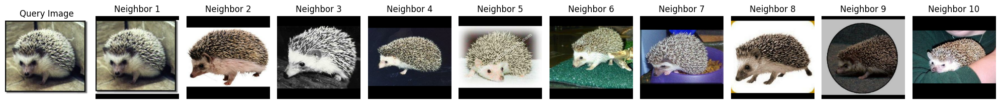

Nearest Neighbors indices: [6882  708 3513 7838 8372 2938 1365 8513 4374 1553]


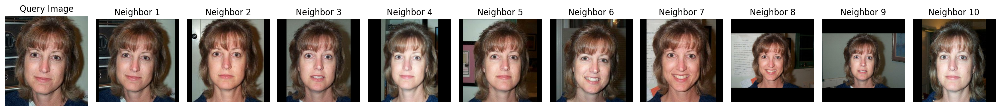

Nearest Neighbors indices: [3967 7577 4696 5205 2101  147 9021 3154 5391 5213]


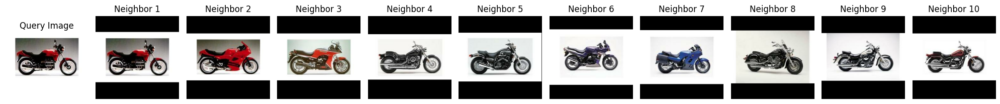

Nearest Neighbors indices: [1613 4676 8732  178 7833 2718 4018 7488  239 3223]


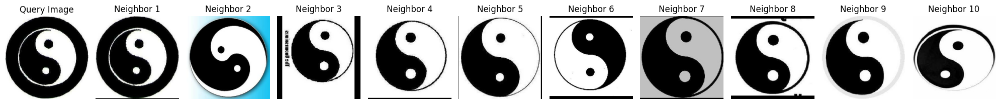

Nearest Neighbors indices: [1046 6930 3515 1303 6108 3483 6787  828 6952 1937]


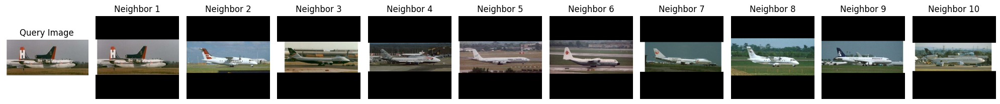

Nearest Neighbors indices: [4751 8733 4077 3978 3502 3600 1574 1604 2076 1025]


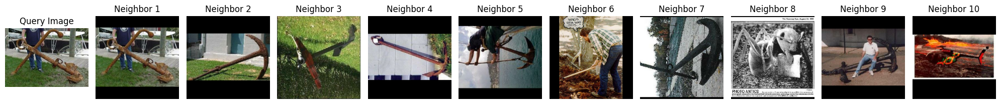

Nearest Neighbors indices: [3817 3578 8077 4673 4815 3045 7933 3375 8838 9076]


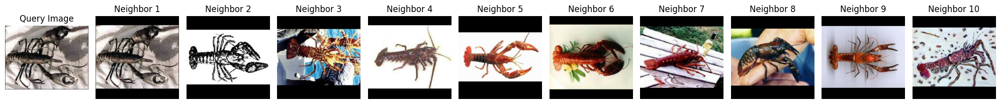

Nearest Neighbors indices: [1400 2259 3957 8623 7937 6578 8214 6582 2661 4730]


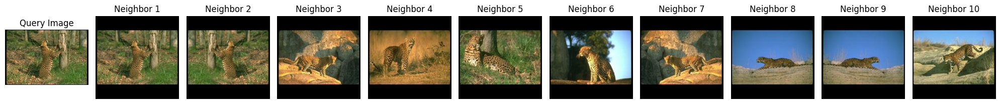

Nearest Neighbors indices: [1824 6374 2535 2119 3040 6558 8470 3001 4333 3418]


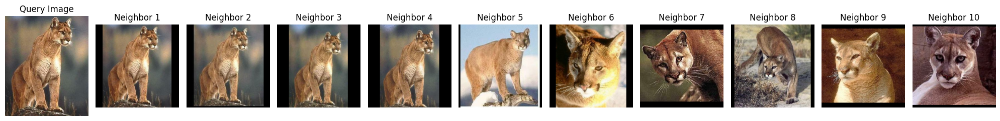

In [35]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

# Compute cosine similarity between query images and dataset images
cosine_similarities = cosine_similarity(features, features)

# Find nearest neighbors for each query image
num_neighbors = 10 
nearest_neighbors_indices = np.argsort(-cosine_similarities, axis=1)[:, :num_neighbors]

# Find nearest neighbors for each query image and visualize
for query_index in random_query_images:
    neighbor_indices = nearest_neighbors_indices[query_index]
    print("Nearest Neighbors indices:", neighbor_indices)
   
    # Get the actual images corresponding to the neighbor indices and resize them
    neighbor_images = []
    for index in neighbor_indices:
        image, _ = next(iter(dataset_original.skip(index).take(1)))
        resized_image = preprocess_image_2(image, None)[0] 
        neighbor_images.append(resized_image)

    # Define a function to visualize images
    def visualize_images(query_image, neighbor_images):
        # Display the query image
        plt.figure(figsize=(20, 5))
        plt.subplot(1, len(neighbor_images) + 1, 1)
        plt.imshow(query_image)  # Display the query image
        plt.title('Query Image')
        plt.axis('off')
    
        # Display images of nearest neighbors
        for i, image in enumerate(neighbor_images, start=2):
            plt.subplot(1, len(neighbor_images) + 1, i)
            plt.imshow(image)  # Display the neighbor image
            plt.title(f'Neighbor {i-1}')
            plt.axis('off')
    
        plt.tight_layout()
        plt.show()
    
    # Call the visualization function
    visualize_images(next(iter(dataset_original.skip(query_index).take(1)))[0], neighbor_images)

## Visualize the Feature Distribution

## PCA

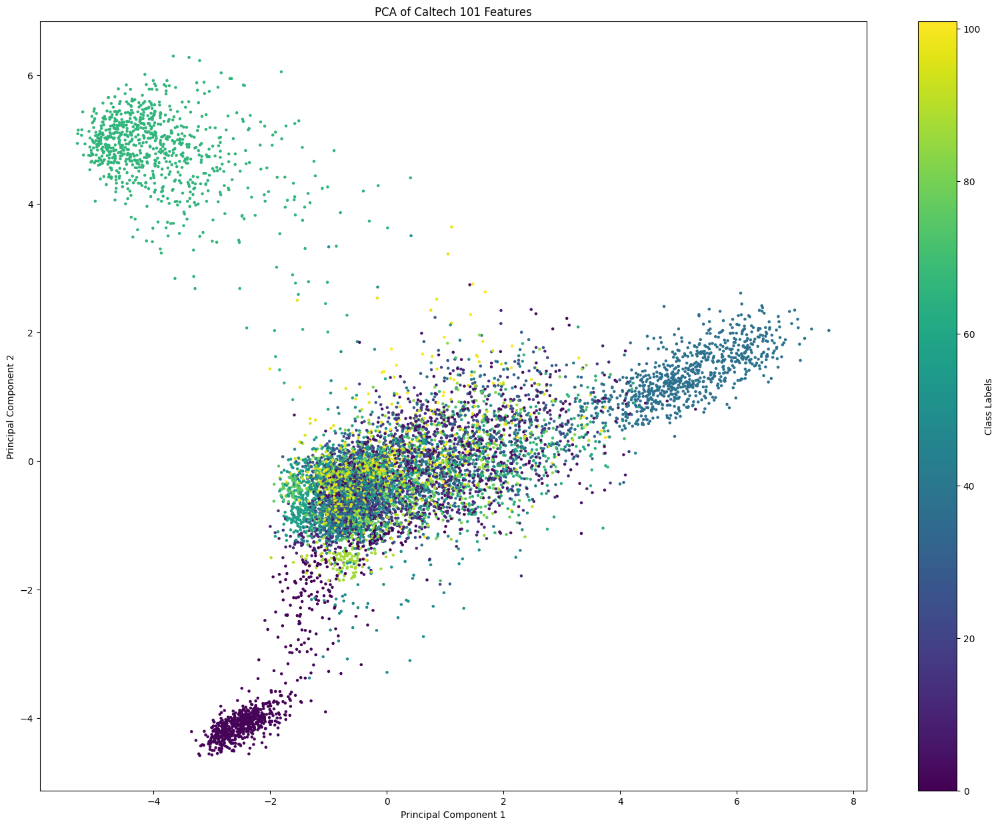

In [36]:
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

features: np.ndarray = np.load('features_.npy')
labels: np.ndarray = np.load('labels_.npy')

pca = PCA(n_components=2)
reduced_features = pca.fit_transform(features)

plt.figure(figsize=(20,15))
plt.scatter(reduced_features[:, 0], reduced_features[:, 1], c=labels, cmap='viridis', s=5)
plt.colorbar(label='Class Labels')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA of Caltech 101 Features')
plt.show()


## t-SNE

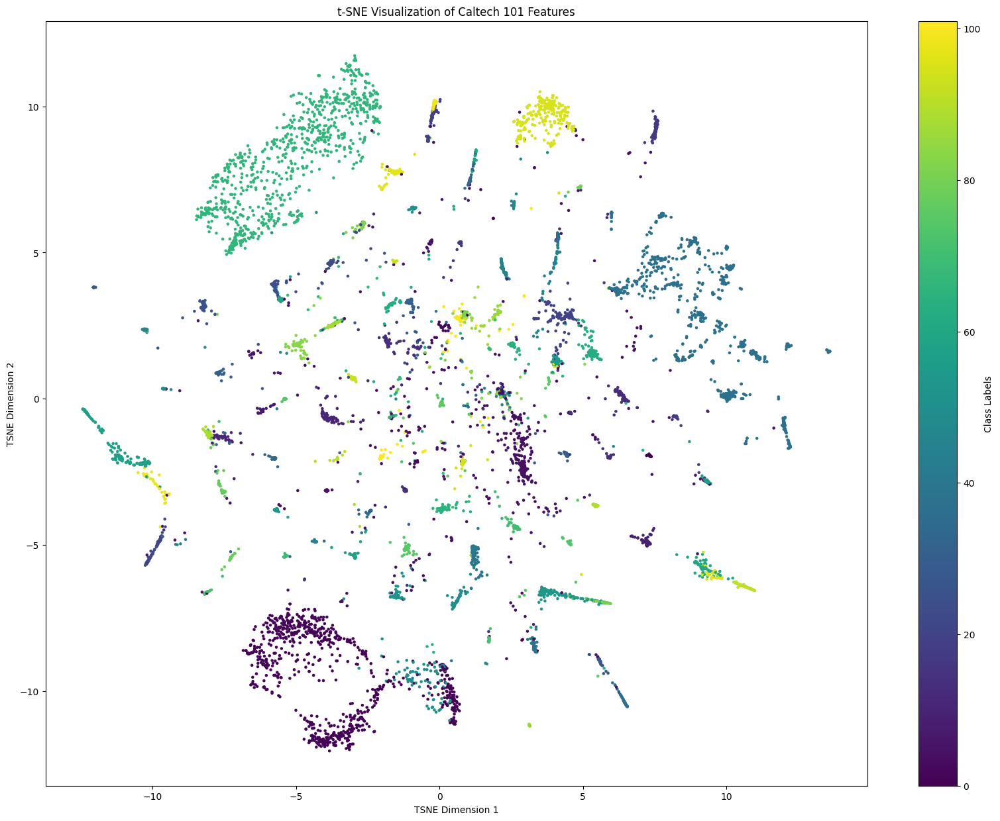

In [37]:
from sklearn.manifold import TSNE

tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
tsne_features = tsne.fit_transform(features)

plt.figure(figsize=(20,15))
plt.scatter(tsne_features[:, 0], tsne_features[:, 1], c=labels, cmap='viridis', s=5)
plt.colorbar(label='Class Labels')
plt.xlabel('TSNE Dimension 1')
plt.ylabel('TSNE Dimension 2')
plt.title('t-SNE Visualization of Caltech 101 Features')
plt.show()


## Box Plot: First Feature across different classes

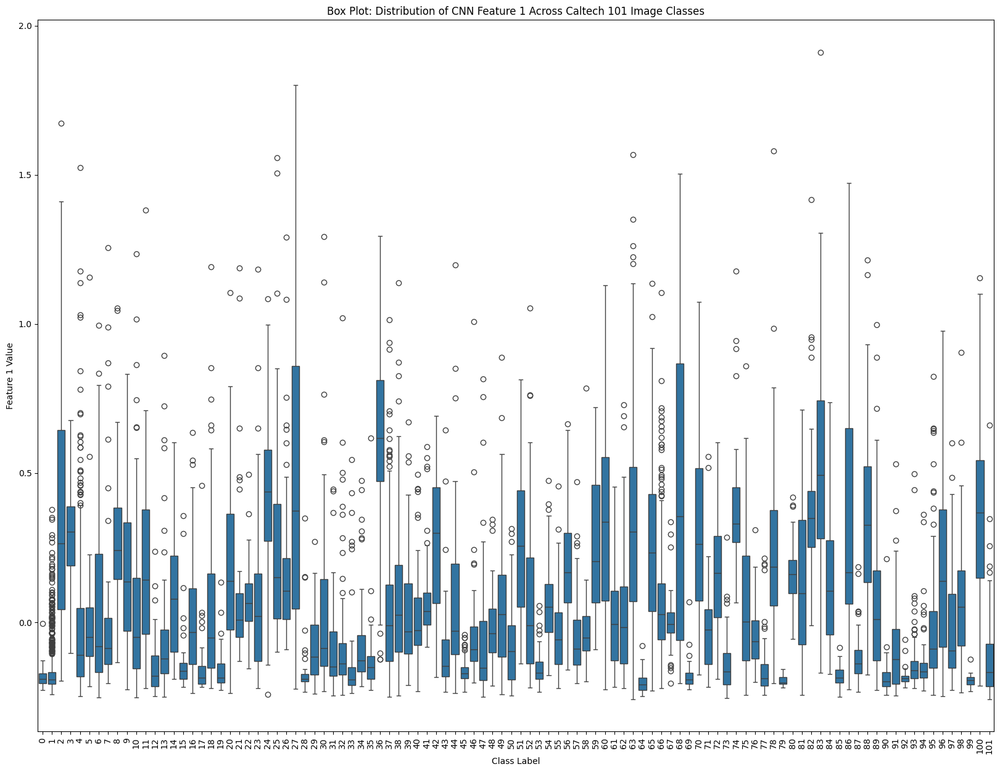

In [38]:
import seaborn as sns

plt.figure(figsize=(20, 15))
sns.boxplot(x=labels, y=features[:, 0])
plt.xlabel('Class Label')
plt.ylabel('Feature 1 Value')
plt.title('Box Plot: Distribution of CNN Feature 1 Across Caltech 101 Image Classes')
plt.xticks(rotation=90)
plt.show()


## Visualize the patterns in the images using t-SNE (1000 images)

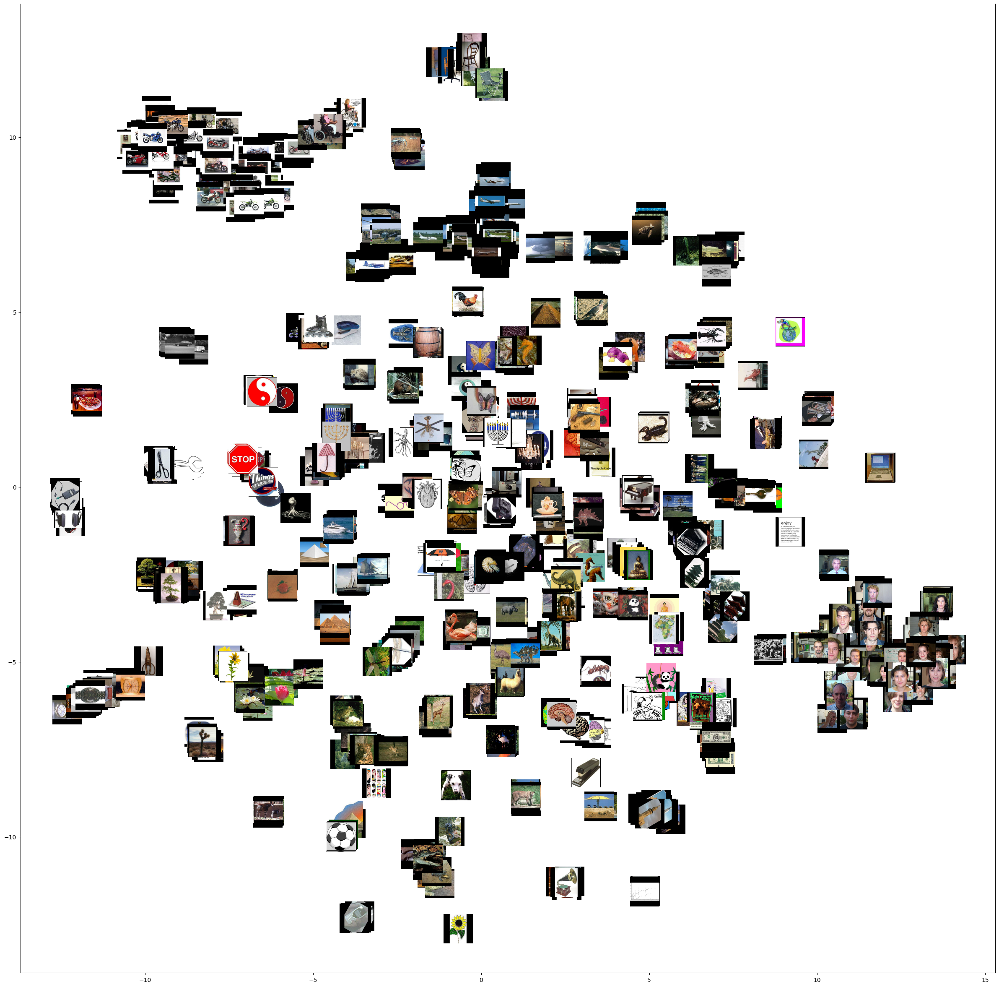

In [39]:
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from PIL import Image, ImageOps

def load_and_preprocess_image(index, dataset):
    image, _ = next(iter(dataset.skip(index).take(1)))
    processed_image = preprocess_image_2(image, None)[0]
    img_array = processed_image.numpy() if isinstance(processed_image, tf.Tensor) else processed_image
    return Image.fromarray((img_array * 255).astype(np.uint8))

def plot_images_in_2d(x, y, images, axis=None, zoom=1):
    if axis is None:
        axis = plt.gca()
    x, y = np.atleast_1d(x, y)
    for x0, y0, img in zip(x, y, images):
        img = ImageOps.fit(img, (100, 100), Image.Resampling.LANCZOS)
        img = OffsetImage(img, zoom=zoom)
        anno_box = AnnotationBbox(img, (x0, y0), xycoords='data', frameon=False)
        axis.add_artist(anno_box)
    axis.update_datalim(np.column_stack([x, y]))
    axis.autoscale()

def show_tsne(features, dataset, num_images=1000, zoom=0.3, size=(22, 22)):

    tsne = TSNE(n_components=2, perplexity=30, n_iter=300)
    tsne_results = tsne.fit_transform(features[:num_images])

    images = [load_and_preprocess_image(i, dataset) for i in range(num_images)]

    fig, axis = plt.subplots()
    fig.set_size_inches(size[0], size[1], forward=True)
    plot_images_in_2d(tsne_results[:, 0], tsne_results[:, 1], images, zoom=zoom, axis=axis)
    plt.show()

features = np.load('features_.npy')
show_tsne(features, dataset_original, zoom=0.5, size=(30, 30))


# Search on new images

## Extract features of new images

In [40]:
import os

def load_and_preprocess_image(file_path: str) -> tf.Tensor:
    image = tf.io.read_file(file_path)
    image = tf.image.decode_image(image, channels=3, expand_animations=False)
    image = tf.image.resize(image, [224, 224])
    image = tf.cast(image, tf.float32)
    return image

folder_path = 'new_images'
image_files = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.jpg', '.png', '.jpeg'))]
images_set = tf.data.Dataset.from_tensor_slices(image_files)
images_set = images_set.map(load_and_preprocess_image)

batch_size = 32
images_set = images_set.batch(batch_size)
images_set = images_set.prefetch(tf.data.AUTOTUNE)

feature_extractor = tf.keras.Model(inputs=model.input, outputs=model.get_layer('global_average_pooling2d').output)

def extract_features(images: tf.data.Dataset) -> np.ndarray:
    features = []
    for batch_images in images:
        batch_features = feature_extractor(batch_images)
        features.extend(batch_features.numpy())
    return np.array(features)

new_images_features = extract_features(images_set)


Nearest Neighbors indices: [[7122 3828 8395 2434 4177 7678 6591 7893 8372 7948]]
Distances: [[ 9.36917824 10.05894978 10.06850646 10.13146014 10.19428071 10.29591412
  10.32476546 10.35854095 10.37240861 10.38051021]]


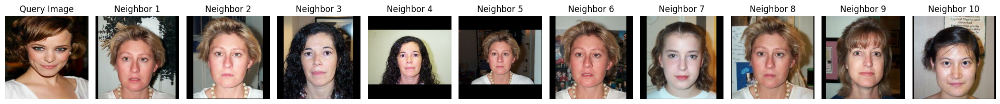

Nearest Neighbors indices: [[4123 4721 5990 4963 2319 5744 2729 1674 5769 4544]]
Distances: [[3.92236202 4.1177764  4.24683105 4.48037408 4.65120575 4.71294376
  4.77602252 4.96365347 4.9649202  4.99956307]]


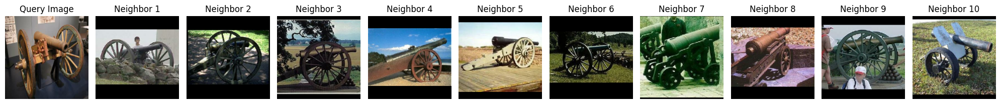

Nearest Neighbors indices: [[3910 4462   64 5168 5923 4427 5552 2374 5095 9053]]
Distances: [[ 8.5341224   8.93925223  9.4803196   9.53854152  9.95833457  9.97341848
  10.28402823 10.4997883  10.53845018 10.61259187]]


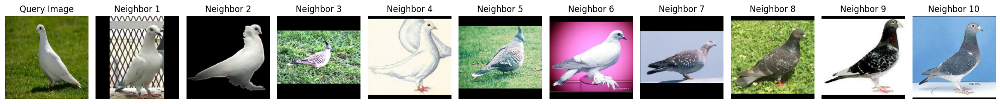

Nearest Neighbors indices: [[5373 5527 8187 9077 6761  982 6504 2010 6994 1924]]
Distances: [[4.4295001  4.68085624 4.73488314 4.76899197 4.94698144 4.98306007
  5.00996113 5.01459806 5.02991095 5.0391045 ]]


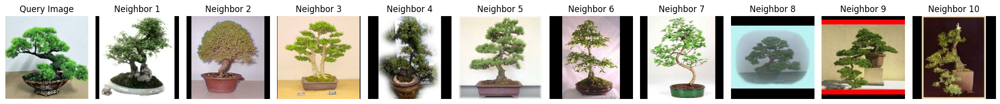

Nearest Neighbors indices: [[ 841 3496 2261 5686 4939 7005 2506 5738 8357 5327]]
Distances: [[3.79534739 3.9598079  3.99479108 4.05750931 4.09661557 4.19909804
  4.33035753 4.38741621 4.46809061 4.46984284]]


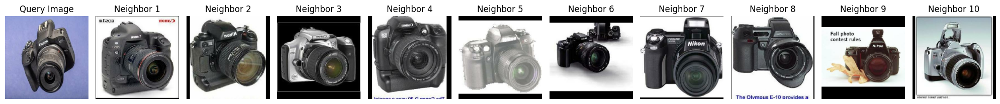

Nearest Neighbors indices: [[3425 6312 7801 8061 2744  356 2030 2771 5300 3083]]
Distances: [[14.33161626 14.4106705  14.47694649 14.67510556 14.68856529 14.73696169
  14.73971025 14.74129805 14.75297514 14.76370187]]


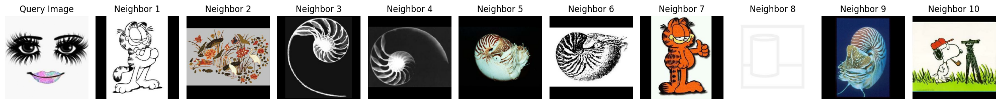

Nearest Neighbors indices: [[8243 3326 7261 7302 8362 9127 8965 6697 4402  279]]
Distances: [[ 9.60942052  9.91547095 10.22590346 10.35051037 10.36050019 10.58916288
  10.59678909 10.70244622 10.89780191 10.93024924]]


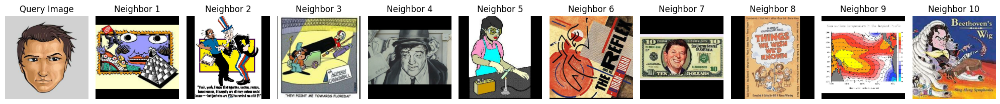

Nearest Neighbors indices: [[7948 2358 2434 2494 6591 8395 3184 6066 1374 7914]]
Distances: [[ 9.57280983  9.79363656  9.93821903  9.94154837 10.03464744 10.1140929
  10.25661089 10.3661614  10.38340552 10.49111303]]


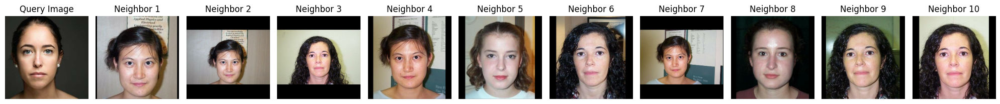

Nearest Neighbors indices: [[8666 1969 4438 2373 7998 5019 2816 6984 1801 4533]]
Distances: [[6.08950159 6.24239481 6.48058943 6.5702818  6.57224099 6.62304541
  6.64375277 6.66862185 6.77929629 6.90881958]]


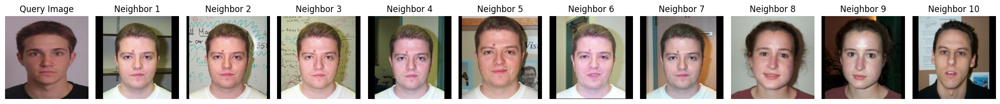

Nearest Neighbors indices: [[7302  400 4862 6826 1685 8965 4533 5850 2695 6135]]
Distances: [[10.32790015 10.53740929 10.60966849 10.66193438 10.70668335 10.71018126
  10.91533208 10.94302852 10.98864171 11.00916113]]


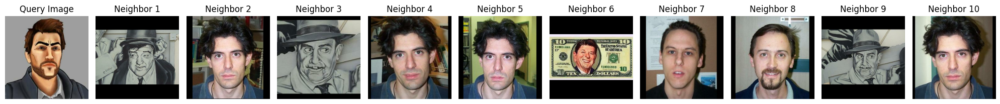

Nearest Neighbors indices: [[ 637 3191 5272 6393 2434 3860 6863 4501 7544 5491]]
Distances: [[ 9.63175702  9.8047775  10.01566738 10.06759169 10.08777948 10.10271581
  10.10977112 10.12723397 10.19865218 10.2014336 ]]


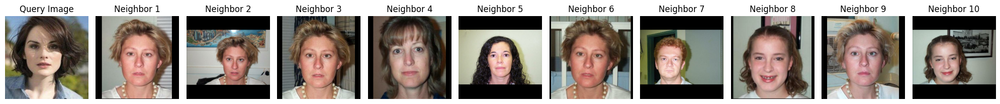

Nearest Neighbors indices: [[ 400 1685 8329 7876 6520 3042 4799 6122 3377 6155]]
Distances: [[11.39967717 11.60848221 11.82038491 11.90072642 11.94538351 11.95054346
  12.04389891 12.07745504 12.11971154 12.16090543]]


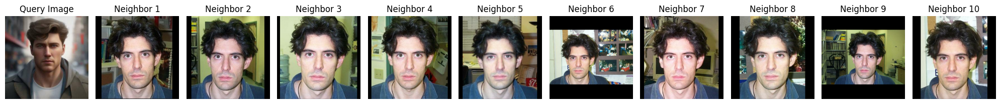

Nearest Neighbors indices: [[6118 3716 7226 4577 3182 5288 5516  656 8230  929]]
Distances: [[3.56343276 4.29154064 4.71258604 4.72173064 5.21656021 5.30289863
  5.37691198 6.18627835 6.26281852 6.28881889]]


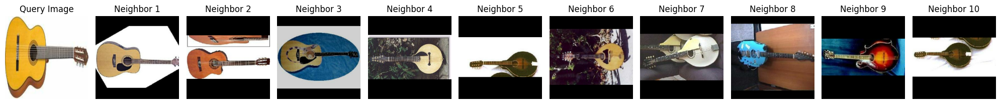

Nearest Neighbors indices: [[3273 3708 7171 8964 5685  564 6446 5269 4441 1299]]
Distances: [[3.2808719  3.65266318 3.7938241  3.92959855 3.93340234 4.08239686
  4.09460864 4.17121026 4.21734982 4.27453063]]


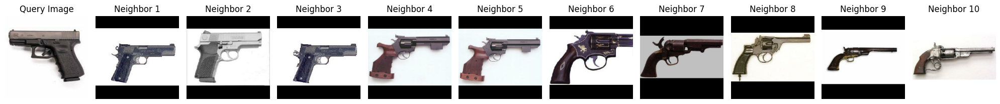

Nearest Neighbors indices: [[4843 7676 6873 9059 2339 7575 7619 5026 5189 5984]]
Distances: [[3.23599978 3.68086936 3.70475031 3.71420493 3.80867212 3.83349592
  3.85188105 3.89165592 3.90795568 3.94742431]]


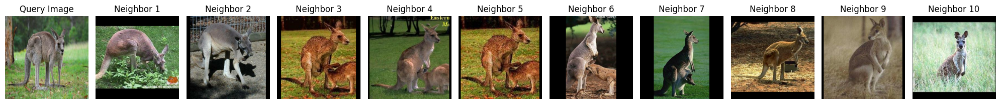

Nearest Neighbors indices: [[3166 3297 5242 1603 6110 8199 4961   10 5507 5576]]
Distances: [[5.0285561  5.2932262  5.35060405 5.40790783 5.50674424 5.51130839
  5.65796696 5.72177992 5.95181034 5.96987715]]


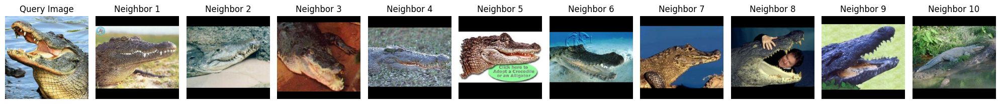

Nearest Neighbors indices: [[4914 2230  966 1960 4669 2149 3658 5257 1757  960]]
Distances: [[ 9.13949731  9.32961297  9.58867609  9.61038605  9.72102196  9.77566077
   9.91188508  9.91615032  9.93298246 10.00707007]]


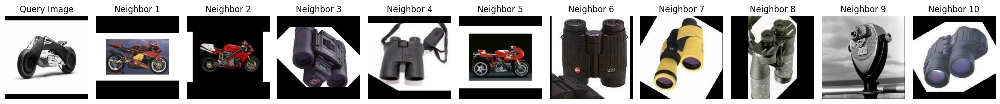

Nearest Neighbors indices: [[1876 6075 2461 3574 4283 1500 1054 6909  593  359]]
Distances: [[2.75490768 2.76543371 2.8399917  2.85673173 2.88159616 2.90310846
  2.91560422 2.92021612 2.93222562 2.95327078]]


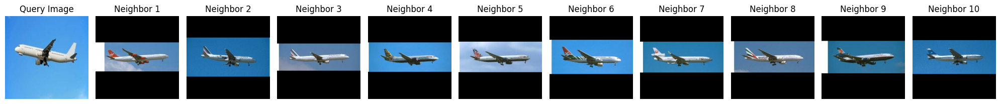

Nearest Neighbors indices: [[2217 4203 2405 1003 8986 3497 2810  151 1028 6200]]
Distances: [[ 9.58211488  9.74284221 10.65724077 10.73503577 10.92947213 10.96328103
  10.99068689 11.02848833 11.52914321 11.65782629]]


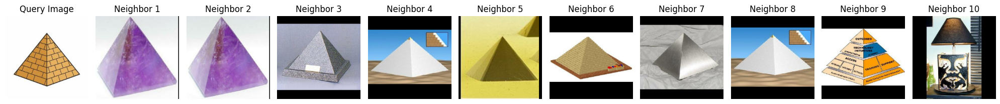

Nearest Neighbors indices: [[5624  153 1243 4190   30 7687 1836 7535 8191 1034]]
Distances: [[6.8370336  6.93772332 7.05930967 7.06678602 7.07994265 7.28662051
  7.42401231 7.42605754 7.45590023 7.47748024]]


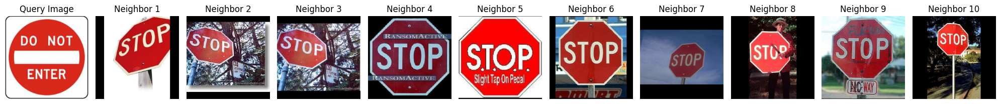

Nearest Neighbors indices: [[1034 1836  393 4992 8191 1243 3405 8170 2095 6154]]
Distances: [[3.5898307  3.77855918 3.95333659 4.37143614 4.43027274 4.504652
  4.56384945 4.5676845  4.64135227 4.69469206]]


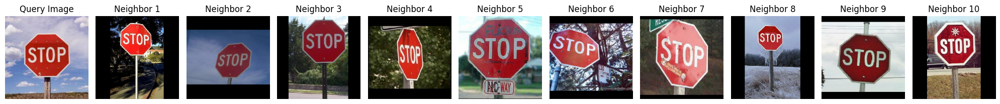

Nearest Neighbors indices: [[3464 3841 1253   30 8820 7524 1346 5607 5033 2323]]
Distances: [[4.47540236 4.87916659 4.93913376 5.28189497 5.37655212 5.41296759
  5.41502885 5.47137176 5.47598806 5.50936294]]


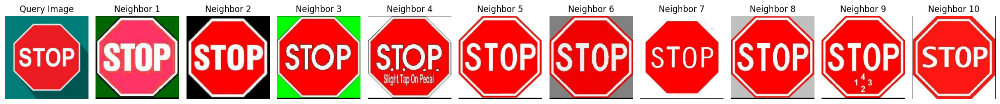

Nearest Neighbors indices: [[2376  687 4046  117 2904 5508  149  921 1535 3798]]
Distances: [[4.16413605 4.39666423 4.53238743 4.6176997  4.64224249 4.68304147
  4.74068314 4.80859956 4.81177026 4.82676461]]


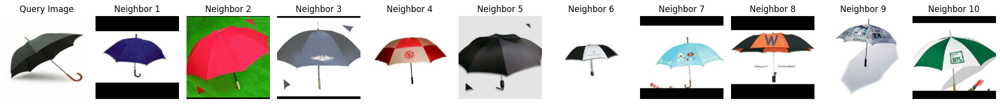

Nearest Neighbors indices: [[8204   91 9060 4891  717 2531  807 3448 8126 7820]]
Distances: [[6.59078893 6.62238776 6.62792274 6.7457487  6.82372005 6.825681
  6.8370327  6.85070438 6.86886229 6.92342926]]


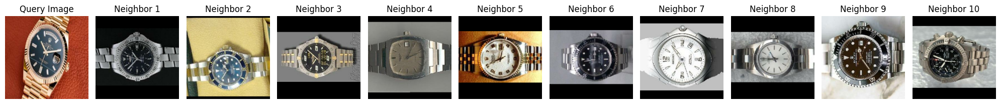

Nearest Neighbors indices: [[2720 1645 6214 3996 2016 3053 5076 3374  507 5760]]
Distances: [[3.25682263 3.37242312 3.40032843 3.40500515 3.44031797 3.44640536
  3.46081902 3.47835508 3.53700317 3.5370986 ]]


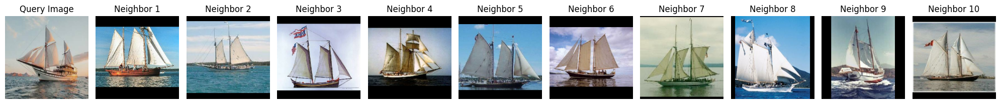

In [41]:
# Train the Nearest Neighbors model
nn = NearestNeighbors(n_neighbors=10, algorithm='ball_tree')
nn.fit(features)

def preprocess_image_2(image, label):
    image = tf.image.resize_with_pad(image, target_height=224, target_width=224)
    image = tf.cast(image, tf.float32) / 255.0
    return image, label

images_set = images_set.unbatch()

# Find nearest neighbors for each query image and visualize
for query_index, img in enumerate(images_set):
    query_image = img.numpy()
    distances, neighbor_indices = nn.kneighbors([new_images_features[query_index]])
    print("Nearest Neighbors indices:", neighbor_indices)
    print("Distances:", distances)
        
    # Get the actual images corresponding to the neighbor indices and resize them
    neighbor_images = []
    for index in neighbor_indices[0]:
        image, _ = next(iter(dataset_original.skip(index).take(1)))
        resized_image = preprocess_image_2(image, None)[0]
        neighbor_images.append(resized_image)

    # Define a function to visualize images
    def visualize_images(query_image, neighbor_images):
        plt.figure(figsize=(20, 5))
        plt.subplot(1, len(neighbor_images) + 1, 1)
        plt.imshow(query_image / 255)
        plt.title('Query Image')
        plt.axis('off')
        
        # Display images of nearest neighbors
        for i, image in enumerate(neighbor_images, start=2):
            plt.subplot(1, len(neighbor_images) + 1, i)
            plt.imshow(image)
            plt.title(f'Neighbor {i-1}')
            plt.axis('off')
        
        plt.tight_layout()
        plt.show()
    
    # Call the visualization function
    visualize_images(query_image, neighbor_images)